This notebook performs the sub-clustering analysis of Astrocytes in the Human MERFISH+ dataset. 

In [1]:
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt
import anndata
import pandas as pd
import scanpy as sc
import rapids_singlecell as rsc

- Function for spatial plot

In [2]:
def plot_cluster_scdata(scdata,cmap,all_clusters,clusters=[1,2],bg_color = 'gray',bg_pt_size = 5, point_sz_map = None, transpose=1,flipx=1,flipy=1,hue_input = 'leiden' , ax = None,use_seaborn = False,show_title = True):
    """
    plot spatial location of cell cluster using either seaborn or matplotlib
    use seaborn for individual clusters
    use matplotlib scatter function to visualize all clusters
    cmap - dictionary that has color of each cluster  used in umap
    """
    fig = None
    if not ax:
     fig,ax = plt.subplots(figsize=(15, 15),)# facecolor="black")

    
    if use_seaborn:
        x,y,hue = 'x', 'y',hue_input
        sns.scatterplot(x=x, y=y, data=scdata.obs, 
                        s=bg_pt_size, markers=dict(marker_edge_color='none'),
                        rasterized=True,
                        ax=ax,c= bg_color)
    else: # use matplotlib
        x,y = (np.array(scdata.obs[['x', 'y']])*[flipx,flipy])[:,::transpose].T
        ax.scatter(x, y, c=bg_color, s = bg_pt_size, marker='.')
        
    for cluster in clusters:
        clst_idx = all_clusters.index(cluster)
        cluster_ = str(cluster)
        inds = scdata.obs[hue_input] == cluster_
        
        #col = cmap[int(clst_idx) % len(cmap)]
        col = cmap[cluster_] # cmap is dictionary
        point_sz = point_sz_map[cluster_] # point size dictionary
        if use_seaborn:
            sns.scatterplot(x=x, y=y, data=scdata.obs[inds], 
                        s=point_sz, markers=dict(marker_edge_color=col),
                        rasterized=True,
                        ax=ax,c= col)
            if show_title:
                ax.set_title(f'cluster {cluster_}',fontsize = 7, y= 1)
        else:
            x_ = x[inds]
            y_ = y[inds]
            ax.scatter(x_, y_, c=col, s= point_sz, marker='.',label = cluster_)
        
        
    
    # ax.set_xlim([x.min(),x.max()])
    # ax.set_ylim([y.min(),y.max()])
    ax.grid(False)
    ax.axis("off")
    ax.axis("equal")
    if fig:
        ax.legend( loc = 'lower center', ncol = len(clusters)//3,markerscale = 12, title = 'Clusters',facecolor = 'black',
            labelcolor = 'white')
        ax.set_title(np.unique(scdata.obs['sample'])[0])
    else:
        # ax.legend( loc = 'lower center')
        pass
        
    ax.autoscale(enable=True, tight=True)
    
   

In [3]:
def rotate(spatial_x,deg):
    """
    spatial_X: Nx2 matrix
    deg: rotation degree in radian
    
    """
    deg = np.deg2rad(deg)
    rotation_mat = np.array([[np.cos(deg),-1*np.sin(deg)],
                            [np.sin(deg),np.cos(deg)]])
    return np.matmul(spatial_x,rotation_mat)

### 1. Prepare data

- Load the adata for the anterior and posterior MERFISH sections.

In [ ]:
%%time

# load 1311 posterior 
Donor_1311_posterior_adata  = anndata.read_h5ad(r'./../../../mapmycell_annotated_adata/MER2_Gpe_Gpi_CaPu_1311__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_1311_posterior_adata.obs = Donor_1311_posterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])


print('load 1311 posterior .....')


# # load 2427 posterior 
Donor_2427_posterior_adata = anndata.read_h5ad(r'./../../../MERFISH_adata_QC/mapmycell_annotated_adata/MER4_Gpe_Gpi_2724__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_2427_posterior_adata.obs = Donor_2427_posterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])
print('load 2427 posterior .....')


# # load 2427 anterior 
Donor_2427_anterior_adata = anndata.read_h5ad(r'./../../../MERFISH_adata_QC/mapmycell_annotated_adata/MER1_CaPuNAC_2427__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_2427_anterior_adata.obs = Donor_2427_anterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])
print('load 2427 anterior .....')


# # load 3924 anterior 
Donor_3924_anterior_adata = anndata.read_h5ad(r'./../../../MERFISH_adata_QC/mapmycell_annotated_adata/MER5_CaPuNAc_3924__MERFISH_annotated.h5ad')
spatialModuleAnnotation = pd.read_csv(r'./../../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/GroupLevelspatialModule_MatrixStriosome_included_cleaned_final.csv', index_col=0)
Donor_3924_anterior_adata.obs = Donor_3924_anterior_adata.obs.join(spatialModuleAnnotation[['Final_Major_region_label','MatrixStriosome_label']])
print('load 3924 anterior  .....')

load 1311 posterior .....
load 2427 posterior .....
load 2427 anterior .....
load 3924 anterior  .....
CPU times: user 1min 25s, sys: 17 s, total: 1min 42s
Wall time: 1min 46s


- concatenate the anndata

- Make sure the same order of genes is used in all samples and replace count with raw counts.

In [5]:
# make sure the same order of genes is used in all samples  and replace count with raw counts
common_gns = np.array(Donor_2427_posterior_adata.var_names)
Donor_1311_posterior_adata.X = Donor_1311_posterior_adata.layers['X_raw']
Donor_1311_posterior_adata = Donor_1311_posterior_adata[:,common_gns].copy()
Donor_1311_posterior_adata.obsm['X_spatial'] = Donor_1311_posterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_1311_posterior_adata.obsm else Donor_1311_posterior_adata.obsm['X_spatial']

Donor_2427_posterior_adata.X = Donor_2427_posterior_adata.layers['X_raw']
Donor_2427_posterior_adata = Donor_2427_posterior_adata[:,common_gns].copy()
Donor_2427_posterior_adata.obsm['X_spatial'] = Donor_2427_posterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_2427_posterior_adata.obsm else Donor_2427_posterior_adata.obsm['X_spatial']

Donor_2427_anterior_adata.X = Donor_2427_anterior_adata.obsm['X_raw']
Donor_2427_anterior_adata = Donor_2427_anterior_adata[:,common_gns].copy()
Donor_2427_anterior_adata.obsm['X_spatial'] = Donor_2427_anterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_2427_anterior_adata.obsm else Donor_2427_anterior_adata.obsm['X_spatial']

Donor_3924_anterior_adata.X = Donor_3924_anterior_adata.layers['X_raw']
Donor_3924_anterior_adata = Donor_3924_anterior_adata[:,common_gns].copy()
Donor_3924_anterior_adata.obsm['X_spatial'] = Donor_3924_anterior_adata.obsm['X_spatial_rotated'] if 'X_spatial_rotated'  in Donor_3924_anterior_adata.obsm else Donor_3924_anterior_adata.obsm['X_spatial']

In [6]:
# concatenate the data
adata = anndata.concat([Donor_1311_posterior_adata,Donor_2427_posterior_adata,Donor_2427_anterior_adata,Donor_3924_anterior_adata],
                       label = 'samples',
                        keys= ['Donor_1311_posterior','Donor_2724_posterior','Donor_2724_anterior','Donor_3924_anterior'],
                        fill_value=0,
                        join='outer',
                        merge='same' ,
                        index_unique='_' # make the cell index unique
                        ) 


In [7]:
adata

AnnData object with n_obs × n_vars = 3250780 × 673
    obs: 'volm', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples'
    obsm: 'X_raw', 'X_spatial', 'X_spatial_rotated', 'X_umap', 'X_pca'
    layers: 'X_raw'

- **NOTE:** The function `anndata.concat` does not concatenate values in layers, so we need to define it again.

In [8]:
adata.layers['X_raw'] = adata.X.copy()

In [9]:
del adata.obsm['X_pca']
del adata.obsm['X_umap']

### 2. Identify astrocytic genes  and subset the data to astrocytes

- First, to identify genes that are specific to Astrocytes perform DEG between astrocyte and the rest of cell-types

- QC: Filter outlier cells

In [10]:
# Remove AC terms concatenated from previous data 
for col in ['n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes']:
    del adata.obs[col]


In [11]:
# Calculate qc metrics 
sc.pp.calculate_qc_metrics(adata,inplace=True)

# QC by count 
totalct_1pp = np.percentile(adata.obs['total_counts'], 1)
totalct_99pp = np.percentile(adata.obs['total_counts'], 99)
totalct_cond = (adata.obs['total_counts'] > totalct_1pp) & (adata.obs['total_counts'] < totalct_99pp)
# QC by volume
Vol_1pp = np.percentile(adata.obs['volm'], 1)
Vol_99pp = np.percentile(adata.obs['volm'], 99)
vol_cond = (adata.obs['volm'] > Vol_1pp) & (adata.obs['volm'] < Vol_99pp)
adata = adata[vol_cond & totalct_cond].copy()
adata

AnnData object with n_obs × n_vars = 3124774 × 673
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    obsm: 'X_raw', 'X_spatial', 'X_spatial_rotated'
    layers: 'X_raw'

- Normalize by count and volume 

In [12]:
# Normalize 
med_volm = np.median(adata.obs['volm'])
temp = adata.X.astype('float').copy()
temp /= adata.obs['volm'].values[:,np.newaxis]
temp *= med_volm
adata.X  = temp
# adata.layer['volm_normed_count'] = temp.copy() # keep copy of the volume normalized count, this is basically RNA-density 

target_sum  = np.median(np.array(adata.X.sum(axis=-1)))
sc.pp.normalize_total(adata, target_sum=target_sum)
sc.pp.log1p(adata)

- Run DEG on individual samples 

In [13]:
from tqdm import tqdm 
ast_markers = []
for sample in tqdm(np.unique(adata.obs['samples']), desc = 'running DEGs'):
    keep = adata.obs['samples'].isin([sample])
    subadata = adata[keep].copy()
    sc.tl.rank_genes_groups(subadata, 'Subclass_name',use_raw = False, method = 'wilcoxon')
    markers = sc.get.rank_genes_groups_df(subadata, 'Astrocyte')
    markers = markers[(markers.pvals_adj < 0.05) & (markers.logfoldchanges > 0.5)].names.values
    ast_markers += [np.unique(markers)]
    del subadata
ast_markers = np.hstack(markers)

running DEGs:   0%|          | 0/4 [00:00<?, ?it/s]/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:456: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packa

- Subset the data to Astrocytes and astrocytic genes.

In [138]:
keep = adata.obs['Subclass_name'].isin(['Astrocyte']) # exclude imastrocyte
adata_astro = adata[keep].copy()
adata_astro = adata_astro[:,ast_markers].copy()
adata_astro

AnnData object with n_obs × n_vars = 447999 × 123
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'x', 'y'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'
    obsm: 'X_raw', 'X_spatial', 'X_spatial_rotated'
    layers: 'X_raw'

### 3. Sub-clustering analysis of astrocytes

In [139]:
adata_astro.X =  adata_astro.layers['X_raw'].copy()

3.1. Further QC focused on astrocytes.

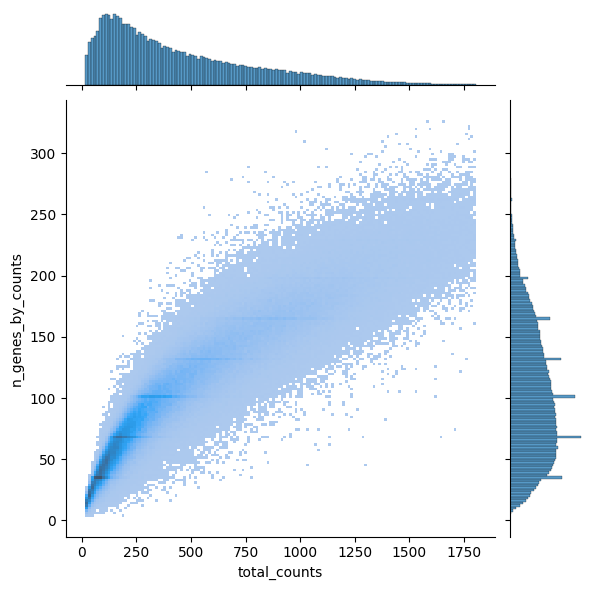

In [140]:
sns.jointplot(adata_astro.obs, x = 'total_counts', y = 'n_genes_by_counts',kind="hist")

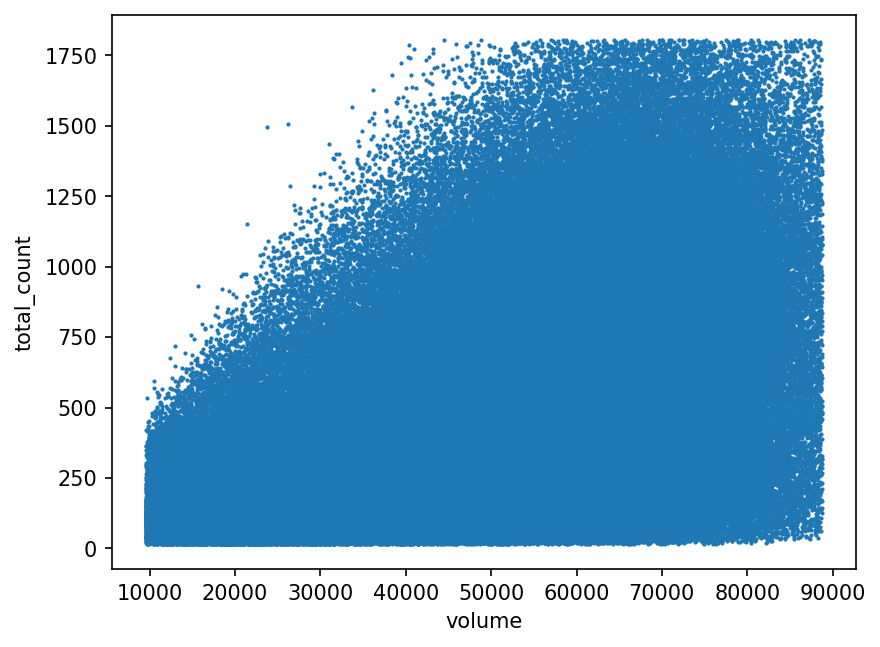

In [141]:

fig,ax = plt.subplots(1,1, dpi = 150)
ax.scatter(adata_astro.obs['volm'], adata_astro.obs['total_counts'],s = 1)
ax.set_xlabel('volume')
ax.set_ylabel('total_count')
plt.show()

A. QC based on volume

In [142]:
astro_1pp_vol = adata_astro.obs['volm'] > np.percentile(adata_astro.obs['volm'],2)
astro_99pp_vol = adata_astro.obs['volm'] < np.percentile(adata_astro.obs['volm'],98)
astro_volm_cond = astro_1pp_vol & astro_99pp_vol
print(f'{astro_volm_cond.sum()}/{astro_1pp_vol.size} cells passed volume QC')

430079/447999 cells passed volume QC


B. QC based on total count

In [143]:
adata_astro.obs['total_counts'] = adata_astro.X.sum(axis=-1)

In [144]:
astro_1pp_totct = adata_astro.obs['total_counts'] > np.percentile(adata_astro.obs['total_counts'],2)
astro_99pp_totct = adata_astro.obs['total_counts'] < np.percentile(adata_astro.obs['total_counts'],98)
astro_totct_cond = astro_1pp_totct & astro_99pp_totct
print(f'{astro_totct_cond.sum()}/{astro_totct_cond.size} cells passed count QC')

429621/447999 cells passed count QC


C. Filter based on transcript density

In [145]:
count_vol_ratio = np.percentile(adata_astro.obs['total_counts']/adata_astro.obs['volm'],20)
count_min = np.percentile(adata_astro.obs['total_counts'],2) # min-count 
RNAdensity_cond = np.greater_equal(adata_astro.obs['total_counts'],count_vol_ratio*adata_astro.obs['volm'] + count_min )
print(f'{RNAdensity_cond.sum()}/{RNAdensity_cond.size} passed QC...')

342617/447999 passed QC...


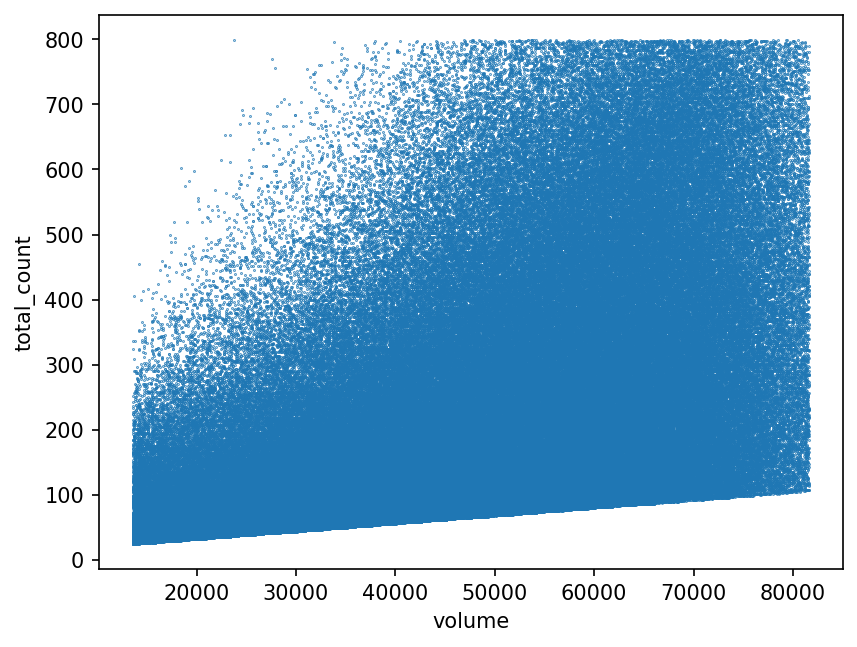

In [146]:
fig,ax = plt.subplots(1,1, dpi = 150)
final_cond = astro_totct_cond & RNAdensity_cond & astro_volm_cond
ax.scatter(adata_astro[final_cond].obs['volm'], adata_astro[final_cond].obs['total_counts'],s = .1)
ax.set_xlabel('volume')
ax.set_ylabel('total_count')
plt.show()

In [147]:
adata_astro = adata_astro[final_cond].copy()
adata_astro

AnnData object with n_obs × n_vars = 319738 × 123
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'x', 'y'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'
    obsm: 'X_raw', 'X_spatial', 'X_spatial_rotated'
    layers: 'X_raw'

In [148]:
np.unique(adata_astro.obs['samples'])

array(['Donor_1311_posterior', 'Donor_2724_anterior',
       'Donor_2724_posterior', 'Donor_3924_anterior'], dtype=object)

3.2. Data Normalization 

1. Normalize the count matrix by volume

In [149]:
%%time
med_volm = np.median(adata_astro.obs['volm'])
temp = adata_astro.X.astype('float').copy()
temp /= adata_astro.obs['volm'].values[:,np.newaxis]
temp *= med_volm
adata_astro.X  = temp

CPU times: user 61.7 ms, sys: 45.5 ms, total: 107 ms
Wall time: 106 ms


2. Normalize by total count and stablize variance 

In [150]:
target_sum  = np.median(np.array(adata_astro.X.sum(axis=-1)))
sc.pp.normalize_total(adata_astro, target_sum=target_sum)
sc.pp.log1p(adata_astro)
# keep record of the log-normalized counts
adata_astro.layers['log_count'] =  adata_astro.X.copy()

In [151]:
adata_astro

AnnData object with n_obs × n_vars = 319738 × 123
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'x', 'y'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'log1p'
    obsm: 'X_raw', 'X_spatial', 'X_spatial_rotated'
    layers: 'X_raw', 'log_count'

3.3. Harmony integration 

A. Run PCA 

In [152]:
# scale and PCA
sc.pp.scale(adata_astro, max_value=10)
# PCA
sc.pp.pca(adata_astro, n_comps=50)

In [153]:
adata_astro

AnnData object with n_obs × n_vars = 319738 × 123
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'x', 'y'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'log1p', 'pca'
    obsm: 'X_raw', 'X_spatial', 'X_spatial_rotated', 'X_pca'
    varm: 'PCs'
    layers: 'X_raw', 'lo

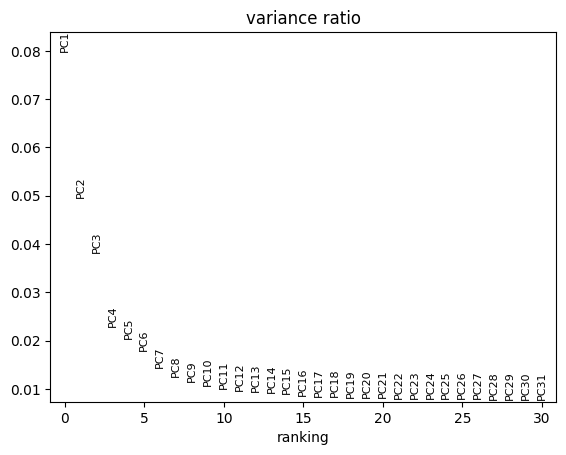

In [154]:
sc.pl.pca_variance_ratio(adata_astro)

B. Run Harmony integration 

In [155]:
%%time
sc.external.pp.harmony_integrate(adata_astro,'samples', basis='X_pca')
adata_astro

2025-09-17 15:19:10,982 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-09-17 15:19:18,773 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-09-17 15:19:19,504 - harmonypy - INFO - Iteration 1 of 10
2025-09-17 15:20:14,604 - harmonypy - INFO - Iteration 2 of 10
2025-09-17 15:21:09,526 - harmonypy - INFO - Converged after 2 iterations


CPU times: user 57min 28s, sys: 13.8 s, total: 57min 42s
Wall time: 1min 58s


AnnData object with n_obs × n_vars = 319738 × 123
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'x', 'y'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'log1p', 'pca'
    obsm: 'X_raw', 'X_spatial', 'X_spatial_rotated', 'X_pca', 'X_pca_harmony'
    varm: 'PCs'
    lay

In [157]:
adata_astro

AnnData object with n_obs × n_vars = 319738 × 123
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'x', 'y'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'log1p', 'pca'
    obsm: 'X_raw', 'X_spatial', 'X_spatial_rotated', 'X_pca', 'X_pca_harmony'
    varm: 'PCs'
    lay

3.4. clustering

A. get the neighborhood graph and the UMAP.

In [158]:
%%time
sc.pp.neighbors(adata_astro, n_neighbors=10,use_rep='X_pca_harmony', n_pcs= 20)  # If n_pcs==0 use .X
print(f'completed building neighbors...')
sc.tl.umap(adata_astro, min_dist=0.1,random_state=3)
print(f'completed umap clustering..')

completed building neighbors...
completed umap clustering..
CPU times: user 26min 49s, sys: 435 ms, total: 26min 49s
Wall time: 2min 13s


- Plot the umap to check the quality of integration

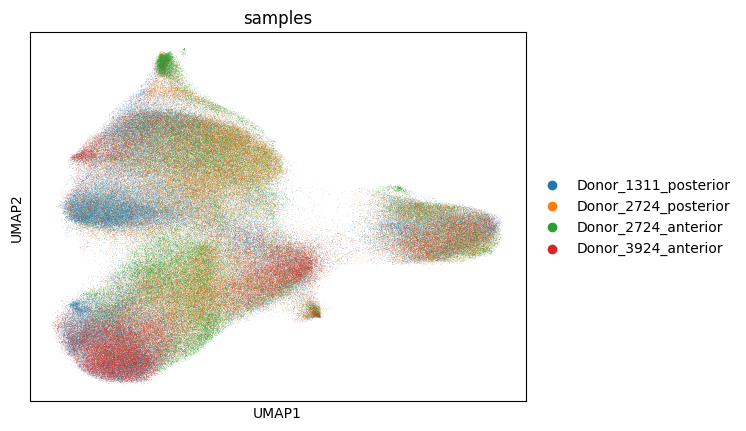

In [159]:
sc.pl.umap(adata_astro, color  = ['samples'])

B. Get the leiden clustering based on the neighborhood graph
- tune the clustering resolution based on the DEGs and the spatial map. 

In [163]:
%%time
rsc.tl.leiden(adata_astro, resolution=0.6)
print(f'completed leiden clustering..')


completed leiden clustering..
CPU times: user 367 ms, sys: 836 ms, total: 1.2 s
Wall time: 1.2 s


- Plot umap

In [164]:
np.unique(adata_astro.obs['leiden'])

array(['0', '1', '2', '4', '5', '6', '7'], dtype=object)

In [166]:
del adata_astro.uns['leiden_colors']

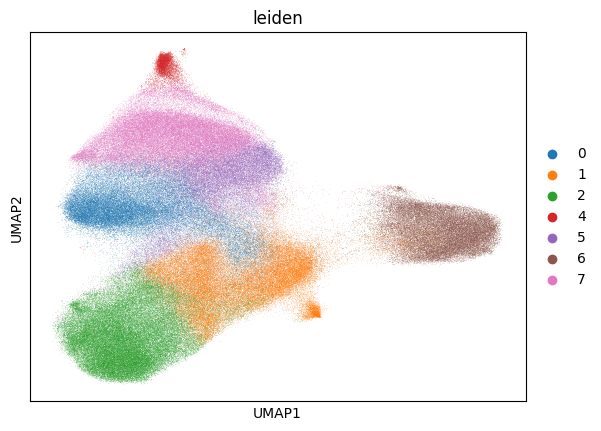

In [167]:
sc.pl.umap(adata_astro, color  = ['leiden'])

C. Compute DEGs between the leiden clusters

In [168]:
sc.tl.rank_genes_groups(adata_astro, 'leiden',use_raw = False, method = 'wilcoxon')
markers = sc.get.rank_genes_groups_df(adata_astro, None)
# markers = markers[(markers.pvals_adj < 0.05) & (markers.logfoldchanges > 0.5)]
markers

/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/home/exx/.conda/envs/rapid_scanpy/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[g

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,0,SLC6A11,249.593185,NaN,0.0,0.0
1,0,MCC,172.657455,NaN,0.0,0.0
2,0,TNC,162.974411,NaN,0.0,0.0
3,0,PTCH1,149.836578,NaN,0.0,0.0
4,0,RGMA,142.310120,NaN,0.0,0.0
...,...,...,...,...,...,...
856,7,OAF,-113.921349,NaN,0.0,0.0
857,7,SDS,-122.920746,NaN,0.0,0.0
858,7,SPARCL1,-144.704788,NaN,0.0,0.0
859,7,APOE,-169.560776,NaN,0.0,0.0


In [195]:
leiden_cluster = 7
markers[markers.group == f'{leiden_cluster}'].iloc[:5,:]

,group,names,scores,logfoldchanges,pvals,pvals_adj
738,7,TNC,240.741058,NaN,0.0,0.0
739,7,AQP1,210.567993,NaN,0.0,0.0
740,7,CD44,198.114090,NaN,0.0,0.0
741,7,SLC24A4,192.403336,NaN,0.0,0.0
742,7,CPAMD8,181.575302,NaN,0.0,0.0


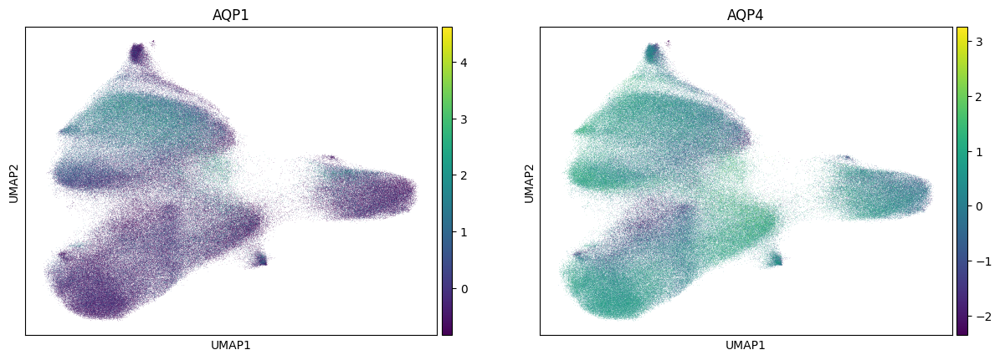

In [187]:
sc.pl.umap(adata_astro, color  = ['AQP1','AQP4'],)

D. Annotation

In [199]:
celltype_mapper = {0:'GP-TH_Astro',1:'STR_Astro-1',2:'STR_Astro-2',4:'Vascular_Astro',5:'Astro_unk',6:'ImAstro',7:'WM_Astro'}
celltype_mapper = {str(k):v for k,v in celltype_mapper.items()}
adata_astro.obs['Astro_subtype'] = adata_astro.obs['leiden'].replace(celltype_mapper)

/tmp/ipykernel_1312307/3155996863.py:3: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata_astro.obs['Astro_subtype'] = adata_astro.obs['leiden'].replace(celltype_mapper)


4. Spatial plot

In [ ]:
cmap = ["#e6194B", "#3cb44b", "#ffe119", "#4363d8", "#f58231", "#911eb4", "#42d4f4", "#f032e6", "#bfef45",
        "#fabed4", "#469990", "#dcbeff", "#9A6324", "#fffac8", "#800000", "#aaffc3", "#808000", "#ffd8b1",
        "#000075", "#a9a9a9"]
# point_sz_map = {clst:1 for clst in np.unique(adata_astro.obs['leiden'])}
# cluster_cmap = {clst:clr for clr,clst in zip(adata_astro.uns['leiden_colors'],adata_astro.obs['leiden'].cat.categories)}



In [ ]:
donor_1311_posterior_spatialModuleContours = np.load(r'./../../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_1311_posterior_StriosomeContours = np.load(r'./../../../spatialDomain_analysis/processed_data/donor_1311_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_posterior_spatialModuleContours = np.load(r'./../../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_posterior_StriosomeContours = np.load(r'./../../../spatialDomain_analysis/processed_data/donor_2724_PosteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_2427_anterior_spatialModuleContours = np.load(r'./../../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_2427_anterior_StriosomeContours = np.load(r'./../../../spatialDomain_analysis/processed_data/chip5_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

donor_3924_anterior_spatialModuleContours = np.load(r'./../../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/spatialModule_Contourcoord.npy',allow_pickle = True).item()
donor_3924_anterior_StriosomeContours = np.load(r'./../../../spatialDomain_analysis/processed_data/donor_3924_AnteriorMERFISH/Striosome_Contourcoord.npy',allow_pickle = True).item()

In [178]:
import seaborn as sns
import matplotlib.patches as patches
import os
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 

adata.obs[['x','y']] = adata.obsm['X_spatial'].copy()
figsize_scale = 8e3

dx_list = []
dy_list = []
samples = np.unique(adata.obs['samples'])
for i,sample in enumerate(samples):
    cond = adata.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample]) # since rotation is could change the xy limit, perform rotation to get accurate estiamte

    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    dx_list += [dx/figsize_scale]
    dy_list += [dy/figsize_scale]
dx_max = np.max(dx_list)  
dy_max = np.max(dy_list)  
print(f'max-width:{dx_max}, max-height:{dy_max}')

max-width:3.4967735624804646, max-height:4.602596514642238


Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


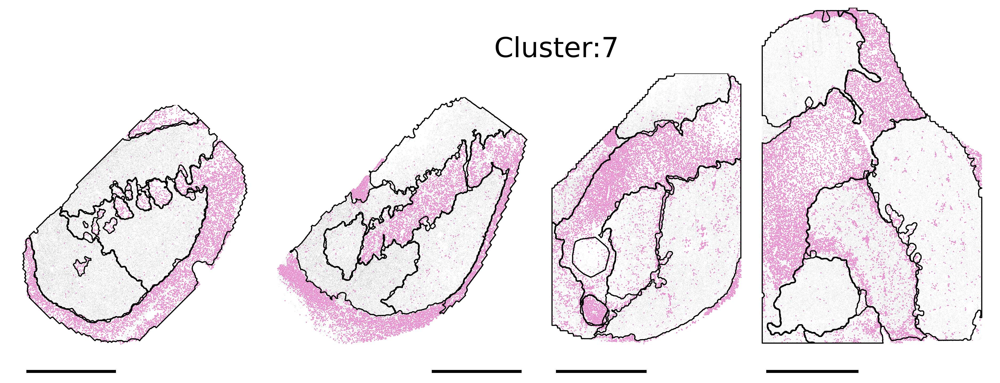

In [196]:
# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import copy
import matplotlib.patches as patches
import os
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.025,'Donor_2724_anterior':0.05,'Donor_2724_posterior':0.03,'Donor_3924_anterior':0.05}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

all_clusters = list(np.unique(adata_astro.obs['leiden']))
clusters_toShow = [f'{leiden_cluster}']
point_sz_map[clusters_toShow[0]] = 1
# point_sz_map[clusters_toShow[1]] = 2
# point_sz_map[clusters_toShow[2]] = 2
# point_sz_map[clusters_toShow[3]] = 2

adata_astro.obs[['x','y']] = adata_astro.obsm['X_spatial'].copy()
figsize_scale = 8e3

fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
bbox = fig.get_tightbbox()
ax = None

samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
# samples = ['Donor_2427_anterior','Donor_1311_posterior']
for sample_idx,sample in enumerate(samples):
    cond = adata_astro.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata_astro[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample])
    cnt = copy.deepcopy(sptial_module_dict[sample])
    strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()

    for label_ in cnt:
        if isinstance(cnt[label_],list):
            for i in range(len(cnt[label_])):
                cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
        else:   
            cnt[label_] = rotate(cnt[label_],rot_deg[sample])
    for idx in range(len(strio_cnt)):
        strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

    if reverse_coord[sample]:
        X_sample = X_sample[:,::-1]
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = cnt[label_][i][:,::-1]
            else:
                cnt[label_] = cnt[label_][:,::-1]
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = strio_cnt[idx][:,::-1]

    adata_astro.obs.loc[cond,['x','y']] = X_sample.copy()
    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    if ax != None:
        bbox = ax.get_position()
    dx = dx/figsize_scale
    dy = dy/figsize_scale
    # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
    dx_frac = dx/fig.get_figwidth()
    dy_frac = dy/fig.get_figheight()
    width_gap = 1
    # if i < 2:
    #     width_gap = 0.8
    # elif i < 3:
    #     width_gap = 0.9
    ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
    plot_cluster_scdata(adata_astro[cond],cluster_cmap,all_clusters = all_clusters,clusters = clusters_toShow,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'leiden' , ax = ax,use_seaborn = True,show_title = False )

    # add the outregion outlines 
    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
        if label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 1, c = 'k')
            else:
                ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 1, c = 'k')

    # add the striosome contour outline
    # for cnt in strio_cnt:
    #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

    # Set the axis limits 
    xmax, ymax = X_sample.max(axis=0)
    xmin, ymin = X_sample.min(axis=0)
    ax.set_xlim([xmin,xmax])
    ax.set_ylim([ymin,ymax + 3500])
    # add scale bar
    scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
    ax.add_patch(scalebar)

    if invert_xaxis[sample]:
        ax.invert_xaxis()
    
    if invert_yaxis[sample]:
        ax.invert_yaxis()
    if sample_idx == 0:
        ax.text(xmin + 2.1*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'Cluster:{leiden_cluster}', fontsize = 25)
    #     ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{figure_title}', fontsize = 25)
    # ax.set_aspect('equal', adjustable ='datalim')

# plt.savefig(r'./figures/Figure3/supplemental' + os.sep + '_'.join(cluster_.split(' ')) + '.png',bbox_inches = 'tight')
# plt.savefig(r'./figures/Figure3/supplemental' + os.sep + '_'.join(cluster_.split(' ')) + '.tif',bbox_inches = 'tight')
plt.show()
    


- Visualize the annoated data

In [201]:
point_sz_map = {clst:1 for clst in np.unique(adata_astro.obs['Astro_subtype'])}
cluster_cmap = {clst:cmap[i%len(cmap)] for i,clst in enumerate(adata_astro.obs['Astro_subtype'].cat.categories)}

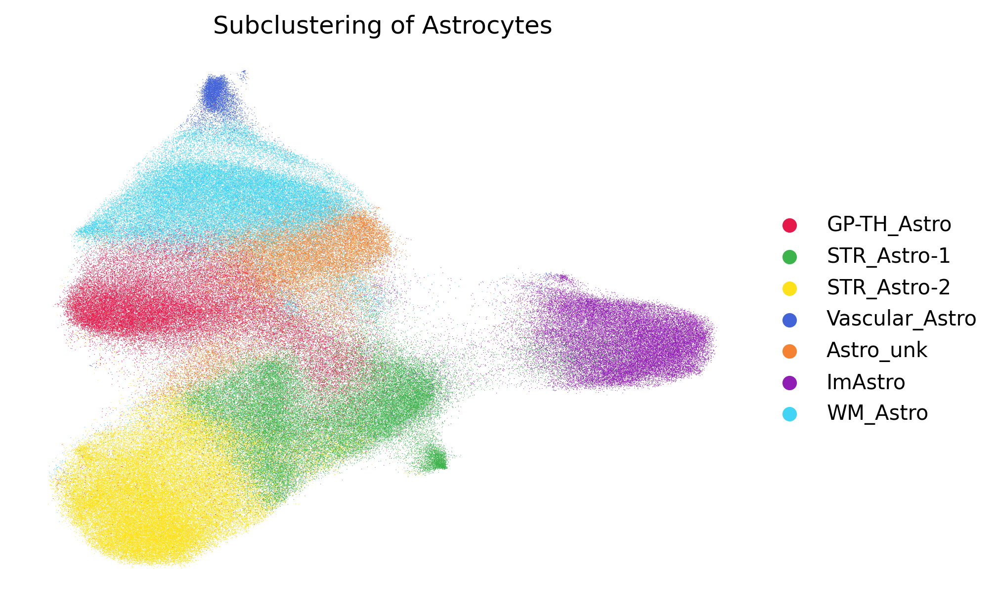

In [206]:
fig,ax = plt.subplots(1,1, dpi = 300)
sc.pl.embedding(adata_astro, basis = 'X_umap',color = ['Astro_subtype'], palette = [cluster_cmap[clst] for clst in adata_astro.obs['Astro_subtype'].cat.categories], ax = ax, show = False, frameon = False, title = 'Subclustering of Astrocytes')
plt.show()

Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


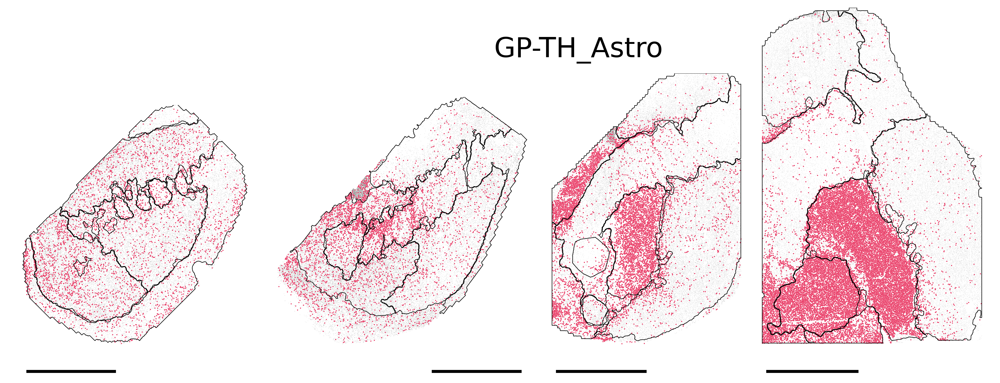

Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


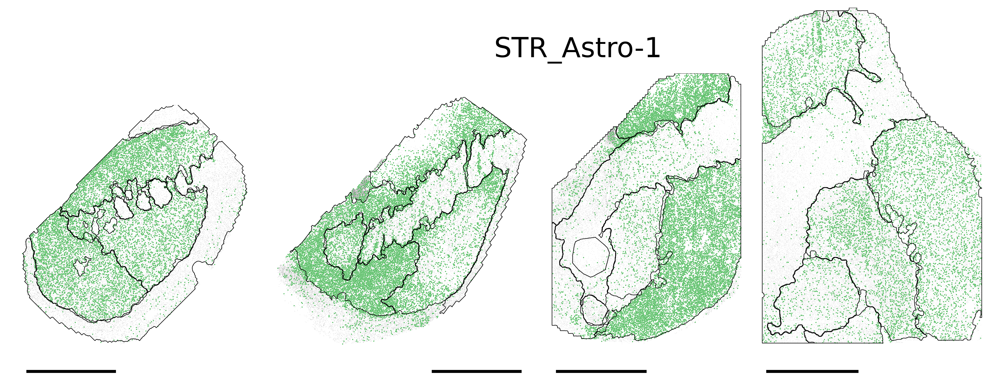

Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


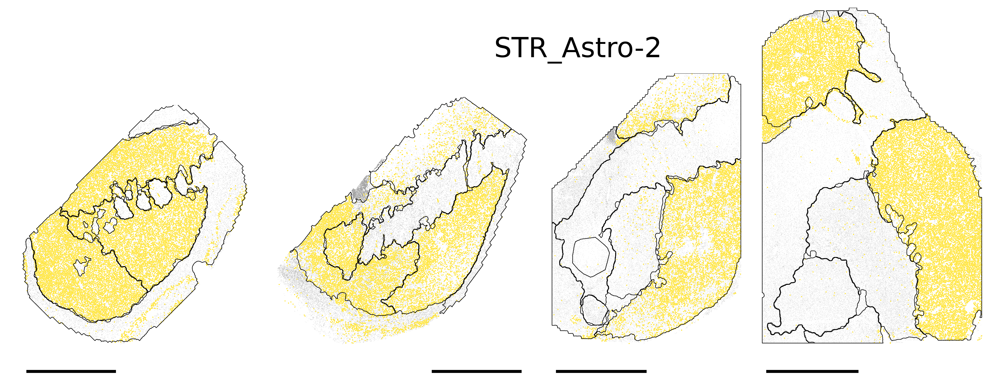

Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


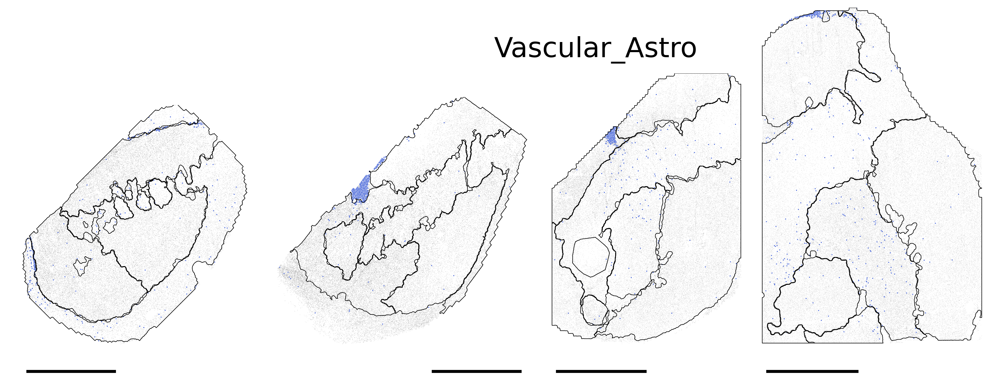

Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


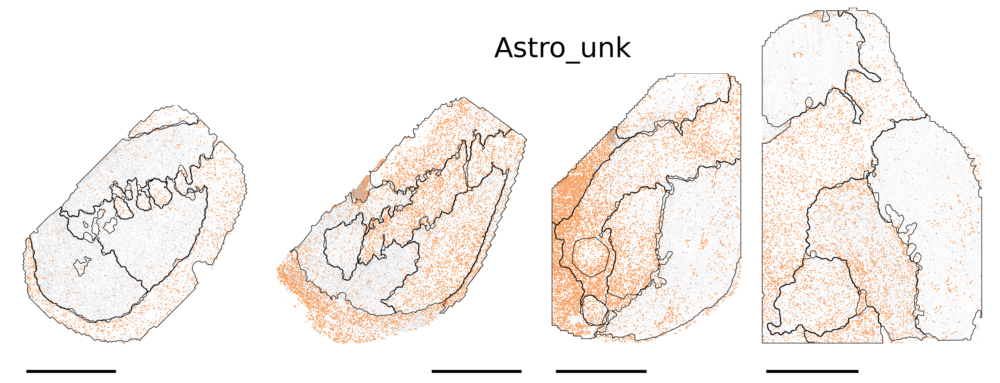

Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


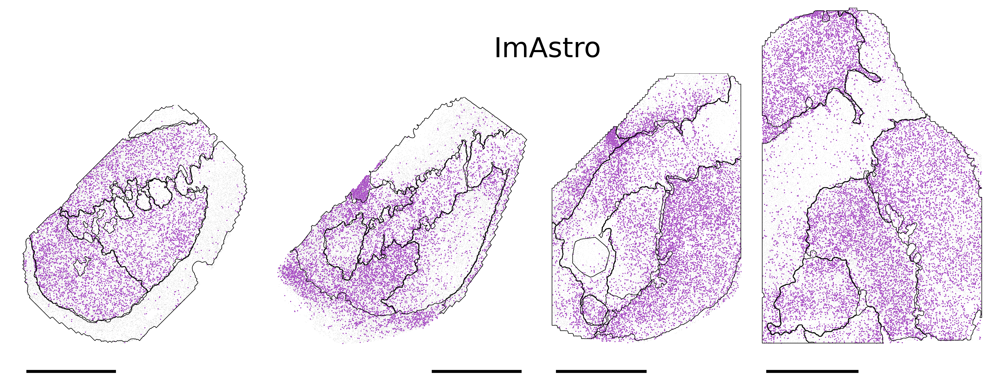

Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


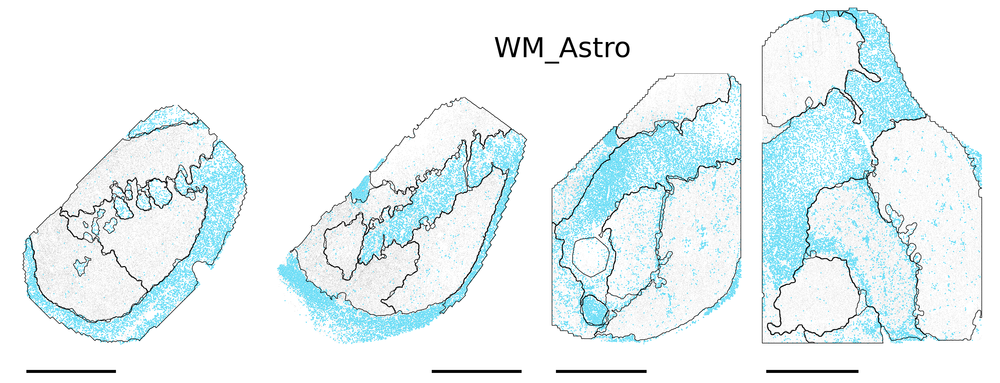

In [209]:

# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import copy
import matplotlib.patches as patches
import os
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.035,'Donor_2724_anterior':0.06,'Donor_2724_posterior':0.04,'Donor_3924_anterior':0.06}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

all_clusters = list(np.unique(adata_astro.obs['leiden']))
clusters_toShow = [f'{leiden_cluster}']
point_sz_map[clusters_toShow[0]] = 1
# point_sz_map[clusters_toShow[1]] = 2
# point_sz_map[clusters_toShow[2]] = 2
# point_sz_map[clusters_toShow[3]] = 2

adata_astro.obs[['x','y']] = adata_astro.obsm['X_spatial'].copy()
figsize_scale = 8e3

for clst in adata_astro.obs['Astro_subtype'].cat.categories:

    fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
    bbox = fig.get_tightbbox()
    ax = None

    samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
    # samples = ['Donor_2427_anterior','Donor_1311_posterior']
    for sample_idx,sample in enumerate(samples):
        cond = adata_astro.obs['samples'] == sample
        # adjucent the spatial coordinate 
        X_sample = adata_astro[cond].obsm['X_spatial'].copy()
        X_sample = rotate(X_sample,rot_deg[sample])
        cnt = copy.deepcopy(sptial_module_dict[sample])
        strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()

        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
            else:   
                cnt[label_] = rotate(cnt[label_],rot_deg[sample])
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

        if reverse_coord[sample]:
            X_sample = X_sample[:,::-1]
            for label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        cnt[label_][i] = cnt[label_][i][:,::-1]
                else:
                    cnt[label_] = cnt[label_][:,::-1]
            for idx in range(len(strio_cnt)):
                strio_cnt[idx] = strio_cnt[idx][:,::-1]

        adata_astro.obs.loc[cond,['x','y']] = X_sample.copy()
        # idenity the proprotion betwen the width and height of the sample
        dx,dy = np.abs(np.ptp(X_sample, axis = 0))
        if ax != None:
            bbox = ax.get_position()
        dx = dx/figsize_scale
        dy = dy/figsize_scale
        # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
        dx_frac = dx/fig.get_figwidth()
        dy_frac = dy/fig.get_figheight()
        width_gap = 1
        # if i < 2:
        #     width_gap = 0.8
        # elif i < 3:
        #     width_gap = 0.9
        ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
        plot_cluster_scdata(adata_astro[cond],cluster_cmap,all_clusters = [clst],clusters = [clst],bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Astro_subtype' , ax = ax,use_seaborn = True,show_title = False )

        # add the outregion outlines 
        for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
            if label_ in cnt:
                if isinstance(cnt[label_],list):
                    for i in range(len(cnt[label_])):
                        ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 0.5, c = 'k')
                else:
                    ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 0.5, c = 'k')

        # add the striosome contour outline
        # for cnt in strio_cnt:
        #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

        # Set the axis limits 
        xmax, ymax = X_sample.max(axis=0)
        xmin, ymin = X_sample.min(axis=0)
        ax.set_xlim([xmin,xmax])
        ax.set_ylim([ymin,ymax + 3500])
        # add scale bar
        scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
        ax.add_patch(scalebar)

        if invert_xaxis[sample]:
            ax.invert_xaxis()
        
        if invert_yaxis[sample]:
            ax.invert_yaxis()
        if sample_idx == 0:
            ax.text(xmin + 2.1*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{clst}', fontsize = 25)
        #     ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{figure_title}', fontsize = 25)
        # ax.set_aspect('equal', adjustable ='datalim')

    # plt.savefig(r'./figures/Figure3/supplemental' + os.sep + '_'.join(cluster_.split(' ')) + '.png',bbox_inches = 'tight')
    # plt.savefig(r'./figures/Figure3/supplemental' + os.sep + '_'.join(cluster_.split(' ')) + '.tif',bbox_inches = 'tight')
    plt.show()
        


- Combined plot

Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.
Ignoring fixed x limits to fulfill fixed data aspect with adjustable data limits.


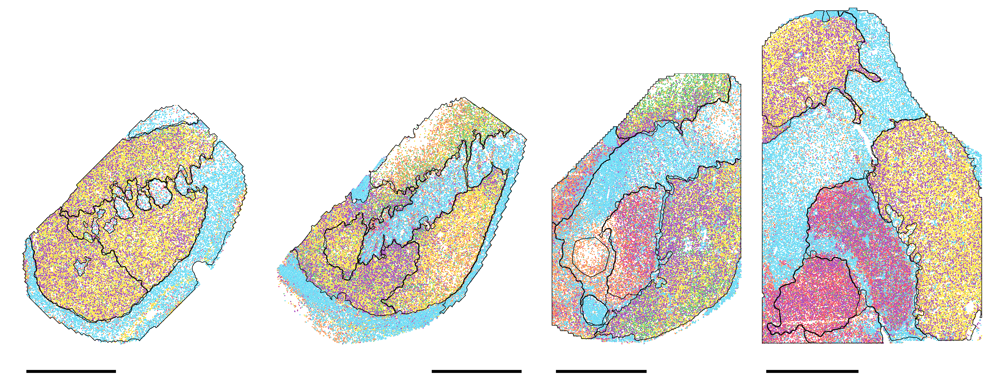

In [252]:

# define canvas for each samples, figure size will be based on the proprotion of the actual tissue size.

# fig,ax = plt.subplots(1,1,dpi = 300, figsize = (15,7))
import seaborn as sns
import copy
import matplotlib.patches as patches
import os
rot_deg = {'Donor_1311_posterior':0, 'Donor_2724_anterior':-45,'Donor_2724_posterior':0,'Donor_3924_anterior':45} # rotation value for each sample 
reverse_coord = {'Donor_1311_posterior':False,'Donor_2724_anterior':True, 'Donor_2724_posterior':False,'Donor_3924_anterior':True }
invert_xaxis = {'Donor_1311_posterior':False,'Donor_2724_anterior':True,'Donor_2724_posterior':False,'Donor_3924_anterior':False }
invert_yaxis = {'Donor_1311_posterior':True,'Donor_2724_anterior':True,'Donor_2724_posterior':True,'Donor_3924_anterior':True}
backgd_sz = {'Donor_1311_posterior':0.035,'Donor_2724_anterior':0.06,'Donor_2724_posterior':0.04,'Donor_3924_anterior':0.06}
# spatial module dictionary
sptial_module_dict = {'Donor_1311_posterior':donor_1311_posterior_spatialModuleContours,'Donor_2724_anterior':donor_2427_anterior_spatialModuleContours,'Donor_2724_posterior':donor_2427_posterior_spatialModuleContours,'Donor_3924_anterior':donor_3924_anterior_spatialModuleContours}
Striosome_module_dict = {'Donor_1311_posterior':donor_1311_posterior_StriosomeContours,'Donor_2724_anterior':donor_2427_anterior_StriosomeContours,'Donor_2724_posterior':donor_2427_posterior_StriosomeContours,'Donor_3924_anterior':donor_3924_anterior_StriosomeContours}

all_clusters = list(np.unique(adata_astro.obs['leiden']))
clusters_toShow = [f'{leiden_cluster}']
point_sz_map[clusters_toShow[0]] = 1
# point_sz_map[clusters_toShow[1]] = 2
# point_sz_map[clusters_toShow[2]] = 2
# point_sz_map[clusters_toShow[3]] = 2

adata_astro.obs[['x','y']] = adata_astro.obsm['X_spatial'].copy()
figsize_scale = 8e3

clustser_toplot = list(adata_astro.obs['Astro_subtype'].cat.categories)

fig = plt.figure(dpi = 300, figsize = (dx_max,dy_max))
bbox = fig.get_tightbbox()
ax = None

samples = ['Donor_3924_anterior','Donor_2724_anterior','Donor_2724_posterior','Donor_1311_posterior']
# samples = ['Donor_2427_anterior','Donor_1311_posterior']
for sample_idx,sample in enumerate(samples):
    cond = adata_astro.obs['samples'] == sample
    # adjucent the spatial coordinate 
    X_sample = adata_astro[cond].obsm['X_spatial'].copy()
    X_sample = rotate(X_sample,rot_deg[sample])
    cnt = copy.deepcopy(sptial_module_dict[sample])
    strio_cnt = Striosome_module_dict[sample]['Striosome'].copy()

    for label_ in cnt:
        if isinstance(cnt[label_],list):
            for i in range(len(cnt[label_])):
                cnt[label_][i] = rotate(cnt[label_][i],rot_deg[sample])
        else:   
            cnt[label_] = rotate(cnt[label_],rot_deg[sample])
    for idx in range(len(strio_cnt)):
        strio_cnt[idx] = rotate(strio_cnt[idx],rot_deg[sample])

    if reverse_coord[sample]:
        X_sample = X_sample[:,::-1]
        for label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    cnt[label_][i] = cnt[label_][i][:,::-1]
            else:
                cnt[label_] = cnt[label_][:,::-1]
        for idx in range(len(strio_cnt)):
            strio_cnt[idx] = strio_cnt[idx][:,::-1]

    adata_astro.obs.loc[cond,['x','y']] = X_sample.copy()
    # idenity the proprotion betwen the width and height of the sample
    dx,dy = np.abs(np.ptp(X_sample, axis = 0))
    if ax != None:
        bbox = ax.get_position()
    dx = dx/figsize_scale
    dy = dy/figsize_scale
    # calculate fraction of the new x and y size as fraction of the previous axis x and y size. we are doing this because, fig.add_axes accept values as fraction of the figure width and hight, 
    dx_frac = dx/fig.get_figwidth()
    dy_frac = dy/fig.get_figheight()
    width_gap = 1
    # if i < 2:
    #     width_gap = 0.8
    # elif i < 3:
    #     width_gap = 0.9
    ax = fig.add_axes([bbox.xmin + width_gap*bbox.width,bbox.ymin,dx_frac, dy_frac], adjustable = 'box')
    plot_cluster_scdata(adata_astro[cond],cluster_cmap,all_clusters = clustser_toplot,clusters = clustser_toplot,bg_color = 'gray',bg_pt_size = backgd_sz[sample], point_sz_map = point_sz_map, transpose=1,flipx=1,flipy=1,hue_input = 'Astro_subtype' , ax = ax,use_seaborn = True,show_title = False )

    # add the outregion outlines 
    for label_ in ['Caudate','Putamen','NAC_shell','NAC_core','Gpi','Gpe','Internal_Capsule','BNST','anterior_commissure','Thalamus']:
        if label_ in cnt:
            if isinstance(cnt[label_],list):
                for i in range(len(cnt[label_])):
                    ax.plot(cnt[label_][i][:,0],cnt[label_][i][:,1], lw = 0.5, c = 'k')
            else:
                ax.plot(cnt[label_][:,0],cnt[label_][:,1], lw = 0.5, c = 'k')

    # add the striosome contour outline
    # for cnt in strio_cnt:
    #     ax.scatter(cnt[:,0],cnt[:,1], s = 0.01, c = 'k')      

    # Set the axis limits 
    xmax, ymax = X_sample.max(axis=0)
    xmin, ymin = X_sample.min(axis=0)
    ax.set_xlim([xmin,xmax])
    ax.set_ylim([ymin,ymax + 3500])
    # add scale bar
    scalebar = patches.Rectangle([xmin + 500,1*ymax + 3000],10000,200,color = 'k')
    ax.add_patch(scalebar)

    if invert_xaxis[sample]:
        ax.invert_xaxis()
    
    if invert_yaxis[sample]:
        ax.invert_yaxis()
    # if sample_idx == 0:
    #     ax.text(xmin + 2.1*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{clst}', fontsize = 25)
    #     ax.text(xmin + 0.2*np.ptp(X_sample[:,0]), ymin - 0.2*np.ptp(X_sample[:,1]), f'{figure_title}', fontsize = 25)
    # ax.set_aspect('equal', adjustable ='datalim')

# plt.savefig(r'./figures/Figure3/supplemental' + os.sep + '_'.join(cluster_.split(' ')) + '.png',bbox_inches = 'tight')
# plt.savefig(r'./figures/Figure3/supplemental' + os.sep + '_'.join(cluster_.split(' ')) + '.tif',bbox_inches = 'tight')
plt.show()
    


In [255]:
adata_astro.write_h5ad(r'./astrocyte_subclustering.h5ad', compression = 'gzip')

In [241]:
np.unique(marker.group)

array(['Astro_unk', 'GP-TH_Astro', 'ImAstro', 'STR_Astro-1',
       'STR_Astro-2', 'Vascular_Astro', 'WM_Astro'], dtype=object)

In [244]:
leiden_cluster = 'WM_Astro'
marker[marker.group == f'{leiden_cluster}'].iloc[:5,:]

,group,names,scores,logfoldchanges,pvals,pvals_adj
738,WM_Astro,TNC,240.741013,3.117612,0.0,0.0
739,WM_Astro,AQP1,210.568115,2.119458,0.0,0.0
740,WM_Astro,CD44,198.114105,2.040278,0.0,0.0
741,WM_Astro,SLC24A4,192.403320,2.466383,0.0,0.0
742,WM_Astro,CPAMD8,181.575272,4.086601,0.0,0.0


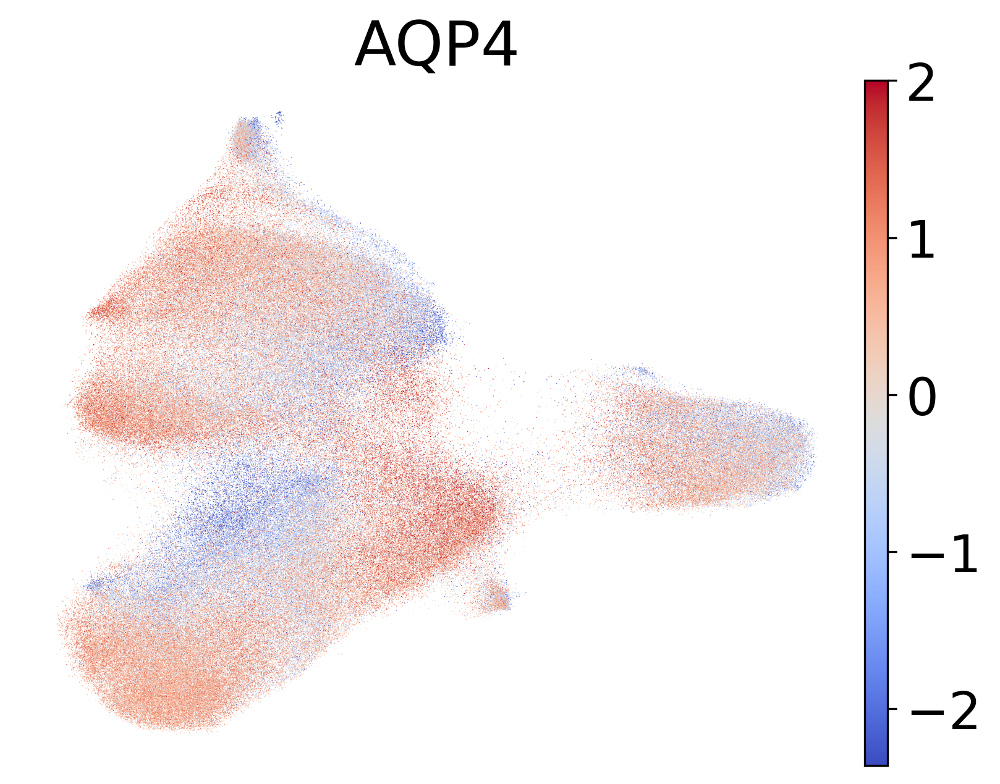

In [251]:
import matplotlib as mpl
mpl.rcParams['font.size'] = 20
fig,ax = plt.subplots(1,1, dpi = 300)
sc.pl.embedding(adata_astro, basis = 'X_umap',color = ['AQP4'], cmap = 'coolwarm', ax = ax, show = False, frameon = False,vmax = 2)
plt.show()

5. Heatmap showing the marker for each Astrocyte subcluster

A. Run DEG analysis between Astrocyte cluster

In [213]:
adata_astro

AnnData object with n_obs × n_vars = 319738 × 123
    obs: 'volm', 'leiden', 'Neighborhood_label', 'Neighborhood_name', 'Neighborhood_bootstrapping_probability', 'Class_label', 'Class_name', 'Class_bootstrapping_probability', 'Subclass_label', 'Subclass_name', 'Subclass_bootstrapping_probability', 'Group_label', 'Group_name', 'Group_bootstrapping_probability', 'Cluster_label', 'Cluster_name', 'Cluster_alias', 'Cluster_bootstrapping_probability', 'Final_Major_region_label', 'MatrixStriosome_label', 'samples', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'x', 'y', 'Astro_subtype'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'samples_colors', 'leiden', 'leiden_colors', 'rank_genes_group

In [214]:
%%time
sc.tl.rank_genes_groups(adata_astro,use_raw = False, groupby ='Astro_subtype', method = 'wilcoxon',layer = 'log_count')

CPU times: user 9.4 s, sys: 36.9 s, total: 46.3 s
Wall time: 2.58 s


In [216]:
marker = sc.get.rank_genes_groups_df(adata_astro,None)
marker = marker[(marker.pvals_adj < 0.05) & (marker.logfoldchanges > 0.5) ]
marker

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,GP-TH_Astro,SLC6A11,249.593185,3.376394,0.000000e+00,0.000000e+00
1,GP-TH_Astro,MCC,172.657227,1.628702,0.000000e+00,0.000000e+00
2,GP-TH_Astro,TNC,162.974442,2.309727,0.000000e+00,0.000000e+00
3,GP-TH_Astro,PTCH1,149.836670,1.816304,0.000000e+00,0.000000e+00
4,GP-TH_Astro,RGMA,142.310104,1.016614,0.000000e+00,0.000000e+00
...,...,...,...,...,...,...
759,WM_Astro,GPC4,42.847218,0.636608,0.000000e+00,0.000000e+00
760,WM_Astro,ZBTB7C,42.448246,0.874144,0.000000e+00,0.000000e+00
762,WM_Astro,SLC14A1,42.049801,0.705619,0.000000e+00,0.000000e+00
770,WM_Astro,MDFIC,15.297731,0.590195,7.916889e-53,1.081975e-52


B. get the log1p expression for top marker genes 

In [218]:
np.unique(adata_astro.obs['Astro_subtype'])

array(['Astro_unk', 'GP-TH_Astro', 'ImAstro', 'STR_Astro-1',
       'STR_Astro-2', 'Vascular_Astro', 'WM_Astro'], dtype=object)

In [222]:
markerGn_exp = []
top_markerGns = []
# for LGE_subtype in np.unique(marker.group):
unique_celltype = ['WM_Astro','STR_Astro-1','STR_Astro-2','GP-TH_Astro','Vascular_Astro','ImAstro','Astro_unk']
for astro_subtype in unique_celltype:

    # get the top 5 genes for the subtype 
    top_gns = marker[marker.group == astro_subtype].names[:10].values.tolist()
    # make sure the genes are not repeated 
    if len(top_markerGns):
        top_gns = list(set(top_gns).difference(top_markerGns))
    top_markerGns += top_gns
    markerGn_exp += [adata_astro[:,top_gns].layers['log_count'].copy()]
markerGn_exp   = np.column_stack(markerGn_exp).T

C. Now z-score the log1p expression of each genes across cells. 

In [223]:
mu = np.mean(markerGn_exp,axis = -1, keepdims = True)
std = np.std(markerGn_exp,axis = -1, keepdims = True)

# for gene shows std is 0, set it to inf show that they do not contribute 
std = np.where(std < 1e-9,np.inf, std)

markerGn_exp_zscore = (markerGn_exp - mu)/ std
markerGn_exp_zscore.shape

(50, 319738)

D. Now sort the cells so that cells of the same type are grouped together.

In [224]:
astrotype_2_num = {astro_subtype:i for i,astro_subtype in enumerate(unique_celltype)} 
cluster_names = np.array(adata_astro.obs['Astro_subtype'].values)
cluster_names_ID = np.array([astrotype_2_num[nm] for nm in cluster_names] )

cell_sortIDX = np.argsort(cluster_names_ID)

In [225]:
markerGn_exp_zscore = markerGn_exp_zscore[:,cell_sortIDX].copy()

E. Now sort the genes so that genes that are expressed most in cells of the same cell tpe are grouped together.

In [226]:
from tqdm import tqdm 
gn_argmaxidx = []
for i,gn in tqdm(enumerate(top_markerGns)):
    df = pd.DataFrame(
     np.column_stack([markerGn_exp_zscore[i,:],cluster_names_ID[cell_sortIDX]]),
     columns = [f'{gn}','celltype_ID']
     )

    df = df.groupby('celltype_ID').mean()
    celltypeID = np.array(df.index).astype(int)
    meanexp = df.values.ravel()
    gn_argmaxidx += [celltypeID[np.argmax(meanexp)]]

50it [00:00, 220.25it/s]


In [227]:
gn_sortidx = np.argsort(gn_argmaxidx)
markerGn_exp_zscore = markerGn_exp_zscore[gn_sortidx,:].copy()

In [228]:
top_markerGns = np.array(top_markerGns)[gn_sortidx]
top_markerGns

array(['TNC', 'AQP1', 'SLC24A4', 'CPAMD8', 'PIRT', 'ADAMTS9', 'SDS',
       'CXCL14', 'VAX1', 'GFRA1', 'COL5A3', 'OAF', 'WIF1', 'TMEM132C',
       'SPARCL1', 'CADM1', 'GLI3', 'SLC1A3', 'NTM', 'ADGRV1', 'ADAMTS17',
       'PLPP3', 'RGMA', 'PTCH1', 'MCC', 'SLC6A11', 'PSD2', 'SYTL4',
       'AEBP1', 'CD44', 'SERPINA3', 'GLIS3', 'ABI3BP', 'PARD3', 'COL27A1',
       'EMP1', 'TOGARAM2', 'SORBS1', 'LYPD1', 'EFEMP1', 'TBXAS1', 'APOE',
       'CST3', 'RBM47', 'CTSH', 'BLNK', 'C3', 'NPL', 'DOCK8', 'CHI3L1'],
      dtype='<U8')

F. Plot the heatmap

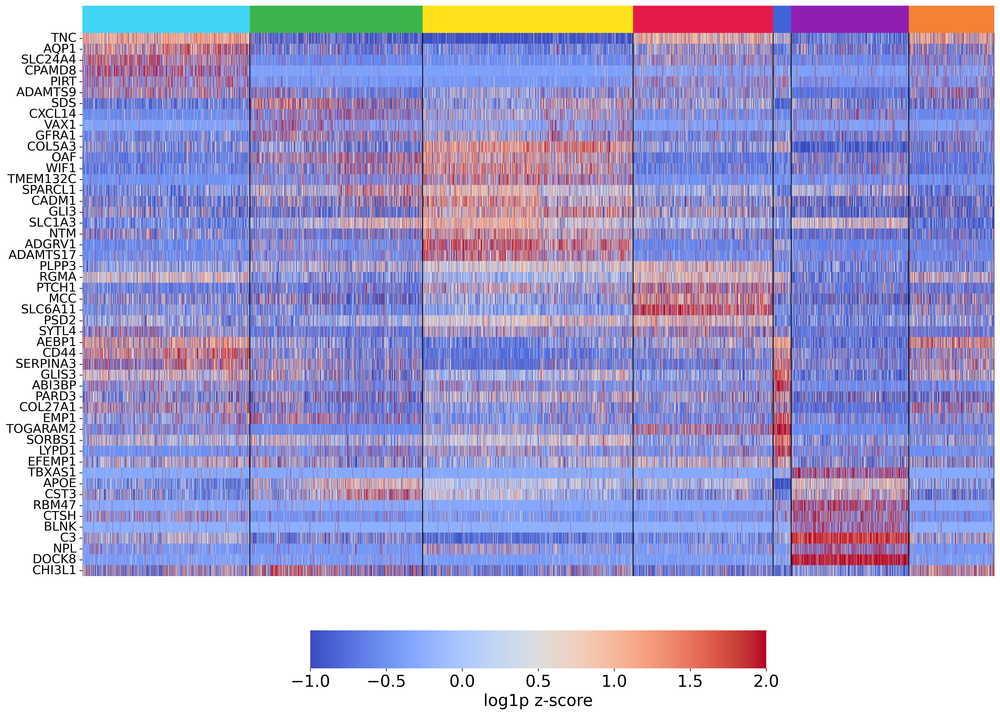

In [238]:
import matplotlib as mpl
import matplotlib.patches as patch
import matplotlib.pyplot as plt
import seaborn as sns
import os

mpl.rcParams['font.size'] = 20


file_name = 'Astrocyte_subtypes_DEG_heatmap'

fig,ax = plt.subplots(1,1, figsize = (20,12), dpi = 300)

# axis for color bar 
bbox = ax.get_position()
# ax_cbar = fig.add_axes([bbox.xmin + 1.05*bbox.width ,bbox.ymin + 0.3*bbox.height ,0.03*bbox.width,0.5*bbox.height])
ax_cbar = fig.add_axes([bbox.xmin + 0.25*bbox.width ,bbox.ymin - 0.17*bbox.height ,0.5*bbox.width,0.07*bbox.height])

     
sns.heatmap(
            markerGn_exp_zscore,
            xticklabels = False,
            yticklabels = top_markerGns,
            cmap = 'coolwarm',
            ax = ax,
            vmax = 2,
            vmin = -1,
            cbar_ax = ax_cbar,
            cbar_kws = {'label':'log1p z-score','orientation':'horizontal'}
            )

# cmap = ["#e6194B", "#3cb44b", "#ffe119", "#4363d8", "#f58231", "#911eb4", "#42d4f4", "#f032e6", "#bfef45",
#         "#fabed4", "#469990", "#dcbeff", "#9A6324", "#fffac8", "#800000", "#aaffc3", "#808000", "#ffd8b1",
#         "#000075", "#a9a9a9"]
# # add a lines and rectangular bars to indicate the cell types
cluster_names_ID_sorted = cluster_names_ID[cell_sortIDX]
end_pts = [np.where(cluster_names_ID_sorted == idx)[0].max() for idx in np.unique(cluster_names_ID_sorted) ]

for i,pt in enumerate(end_pts):
    ax.plot([pt,pt],[0,len(markerGn_exp_zscore)], lw = 1 , c = 'k')

bbox = ax.get_position()
ax1 = fig.add_axes([bbox.xmin,bbox.ymax,bbox.width,0.05*bbox.height])
# choices1 = cmap[:markerGn_exp_zscore.shape[-1]]

num_2_astrotypes = {num:clst for clst,num in astrotype_2_num.items()}
sorted_clusters = [num_2_astrotypes[ID] for ID in np.unique(cluster_names_ID[cell_sortIDX])]
choices1 = [cluster_cmap[clst] for clst in sorted_clusters]
my_colors = tuple(list(choices1)) #('C0', 'C1', 'C2')
cmap_d2 = mpl.colors.LinearSegmentedColormap.from_list('', my_colors, len(my_colors))
sns.heatmap(
            cluster_names_ID_sorted[np.newaxis,:],
            xticklabels = False,
            yticklabels = False,
            ax = ax1,
            cmap = cmap_d2,
            cbar = None,
            )


ax.yaxis.set_tick_params(labelsize=15.2)

# plt.savefig(r'./figures/Figure3/supplemental/Gene_expression_spatialMap/Marker_gene_heatmap' + os.sep + file_name + '.png',bbox_inches = 'tight')
# plt.savefig(r'./figures/Figure3/supplemental/Gene_expression_spatialMap/Marker_gene_heatmap' + os.sep + file_name + '.tif',bbox_inches = 'tight')

plt.show()